# Vegetable classifier using Deep learning 

<b>Author</b> : <a>Sriganesh Venugopal(sriganesh.venugopal@outlook.com)</a>

## Introduction:

In this notebook, we will go through
* data collection 
* data cleanning
* data augumentation
* data exploration




In [3]:
#Import libraries
#----------------

from fastai.vision import *
import warnings
warnings.filterwarnings('ignore')

## Data Collection

As part of data collection all the required images are downloaded using from web. The task is partly automated as given below.

Reference
> 1. https://github.com/hiromis/notes/blob/master/Lesson2.md
> 2. https://www.pyimagesearch.com/2017/12/04/how-to-create-a-deep-learning-dataset-using-google-images/


## Step 1 - Gather URLs for each image classes

1. Open Google images link https://images.google.com/
2. Search for the vegetable name. Use Tools > Usage Rights options to filter based on license
3. Scroll down until you have suffcient images displayed in the web page
4. Press "Command" + "Shift" + "i" to bring up the console and paste the code as shown below and press enter. <b>Note</b>: Make sure to disable add blocker while using this option. 
    > urls = Array.from(document.querySelectorAll('.rg_di .rg_meta')).map(el=>JSON.parse(el.textContent).ou);
      window.open('data:text/csv;charset=utf-8,' + escape(urls.join('\n')));

    > 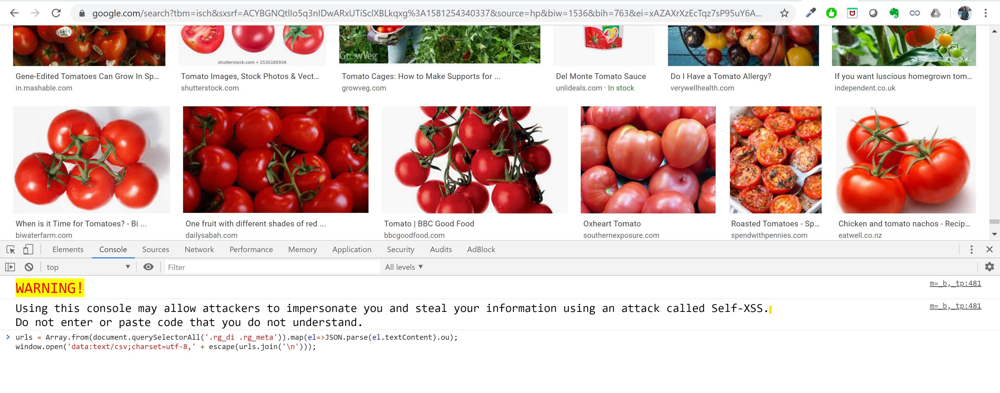
5. The download prompt will appear with file name defaulted to "download". File name should be changed appropriately and downloaded.

## Step 2 - Download images

> * 'folders' list define the folder name for each vegetable class
> * 'files' dictionary specify the URL test file for each vegetable class
> * Loop through each folder and download the images to server.

In [20]:
# destination folder names
folders = ['images/okra','images/brinjal','images/tomato','images/beetroot','images/carrot','images/ginger',
           'images/lemon','images/onion','images/ash gourd','images/beans','images/bitter gourd','images/bottle gourd',
           'images/cabbage','images/capsicum','images/cauliflower','images/chayote','images/drumstick','images/elephant yam',
           'images/green chilli','images/green mango','images/ivy gourd','images/plantain flower','images/plantain stem',
           'images/plantain','images/red raddish','images/ridge gourd','images/shallots','images/snake gourd','images/sweet potato',
           'images/tapioca','images/white raddish','images/yam','images/broccoli','images/cluster beans','images/coconut',
           'images/coriander leaves','images/corn','images/cucumber','images/curry leaves','images/dill','images/fenugreek leaves',
           'images/flat beans','images/gooseberry','images/lime','images/mint','images/mushroom','images/peas','images/pumpkin',
           'images/red chilli','images/turnip','images/white onion','images/zuchini','images/asparagus','images/bamboo shoot',
           'images/basil','images/black raddish','images/celeriac','images/chinese artichokes','images/colocasia','images/dulse',
           'images/fiddleheads','images/garlic','images/kohlrabi','images/long beans','images/lotus root','images/nopal',
           'images/oca','images/potato','images/ramps','images/romanesco'
                   
          ]

In [23]:
# For each vegetable, corresponding URL file name
files = {
        'images/okra' : 'okra.txt',
        'images/brinjal': 'brinjal.txt',
        'images/tomato':'tomato.txt',
        'images/beetroot':'beetroot.txt',
        'images/carrot':'carrot.txt',
        'images/ginger':'ginger.txt',
        'images/lemon':'lemon.txt',
        'images/onion':'onion.txt',
        'images/ash gourd':'ash gourd.txt',
        'images/beans':'beans.txt',
        'images/bitter gourd':'bitter gourd.txt',
        'images/bottle gourd':'bottle gourd.txt',
        'images/cabbage':'cabbage.txt',
        'images/capsicum':'capsicum.txt',	
        'images/cauliflower':'cauliflower.txt',
        'images/chayote':'chayote.txt',
        'images/drumstick':'drumstick.txt',
        'images/elephant yam':'elephant yam.txt',
        'images/green chilli':'green chilli.txt',
        'images/green mango':'green mango.txt',
        'images/ivy gourd':'ivy gourd.txt',
        'images/plantain flower':'plantain flower.txt',
        'images/plantain stem':'plantain stem.txt',
        'images/plantain':'plantain.txt',
        'images/red raddish':'red raddish.txt',
        'images/ridge gourd':'ridge gourd.txt',
        'images/shallots':'shallots.txt',
        'images/snake gourd':'snake gourd.txt',
        'images/sweet potato':'sweet potato.txt',
        'images/tapioca':'tapioca.txt',
        'images/white raddish':'white raddish.txt',
        'images/yam':'yam.txt',
        'images/broccoli':'broccoli.txt',
        'images/cluster beans':'cluster beans.txt',
        'images/coconut':'coconut.txt',
        'images/coriander leaves':'coriander leaves.txt',
        'images/corn':'corn.txt',
        'images/cucumber':'cucumber.txt',
        'images/curry leaves':'curry leaves.txt',
        'images/dill':'dill.txt',
        'images/fenugreek leaves':'Fenugreek leaves.txt',
        'images/flat beans':'flat beans.txt',
        'images/gooseberry':'Gooseberry.txt',
        'images/lime':'lime.txt',
        'images/mint':'mint.txt',
        'images/mushroom':'mushroom.txt',
        'images/peas':'peas.txt',
        'images/pumpkin':'pumpkin.txt',
        'images/red chilli':'red chilli.txt',	
        'images/turnip':'turnip.txt',
        'images/white onion':'white onion.txt',
        'images/zuchini':'zuchini.txt',
        'images/asparagus':'asparagus.txt',
        'images/bamboo shoot':'bamboo shoot.txt',
        'images/basil':'basil.txt',
        'images/black raddish':'black raddish.txt',
        'images/celeriac':'celeriac.txt',
        'images/chinese artichokes':'chinese artichokes.txt',
        'images/colocasia':'colocasia.txt',
        'images/dulse':'dulse.txt',
        'images/fiddleheads':'fiddleheads.txt',
        'images/garlic':'garlic.txt',
        'images/kohlrabi':'kohlrabi.txt',
        'images/long beans':'long beans.txt',
        'images/lotus root':'lotus root.txt',
        'images/nopal':'nopal.txt',
        'images/oca':'oca.txt',
        'images/potato':'potato.txt',
        'images/ramps':'ramps.txt',
        'images/romanesco':'romanesco.txt'        
}

In [19]:
# Loop through each folder, create destination directory. Pick the URL file name from the dictionary and use fast ai 
# download_images function to download the images to the location specified.
path = Path('C:/Users/sriga/Desktop/ML/Springboard/Capstone/Dataset')
for folder in folders:    
    dest = path/folder
    dest.mkdir(parents=True, exist_ok=True)
    file = files[folder]
    download_images(path/file, dest, max_pics=700)

## Data cleanning

> Use fastai 'verify_images' function to check if links are not broken.

In [4]:
# All the classes of vegetables
classes = ['ash gourd','asparagus','bamboo shoot','basil','beans','beetroot','bitter gourd','black raddish','bottle gourd','brinjal','broccoli','cabbage','capsicum','carrot',
           'cauliflower','celeriac','chayote','chilli','chinese artichokes','cluster beans','coconut','colocasia','coriander leaves','corn','cucumber','curry leaves','dill',
           'drumstick','dulse','elephant yam','fenugreek leaves','fiddleheads','flat beans','garlic','ginger','gooseberry','green mango','ivy gourd','kohlrabi','lemon','lime',
           'long beans','lotus root','mint','mushroom','nopal','oca','okra','onion','peas','plantain','plantain flower','plantain stem','potato','pumpkin','ramps','red chilli',
           'red raddish','ridge gourd','romanesco','shallots','snake gourd','sweet potato','tapioca','tomato','turnip','white onion','white raddish','yam', 'zuchini']

In [4]:
# The path where all images are stored.
imgpath = Path('C:/Users/sriga/Desktop/ML/Springboard/vegetable-classifier/exploration/Data/images')
imgpath

WindowsPath('C:/Users/sriga/Desktop/ML/Springboard/vegetable-classifier/exploration/Data/images')

In [6]:
# Loop through all vegetable classes and call verify_images
for c in classes:
    print(c)
    verify_images(imgpath/c, delete=True, max_size=500)

### Manual intervention

 Unfortunately there is need of manual validation and cleanning in few cases as shown below.
 1. More than one vegetable class is present in image. This causes confusion and hence need to be removed.
    > 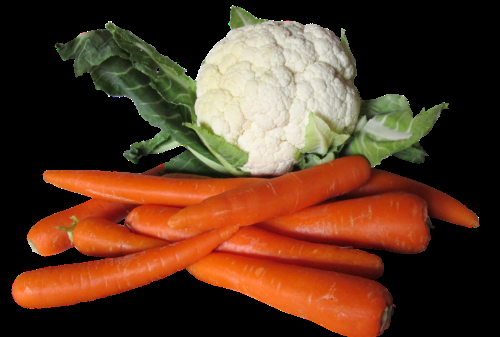
 2. Cooked images of vegetable. Our intent is to identify raw vegetables and hence these images can be removed
    > 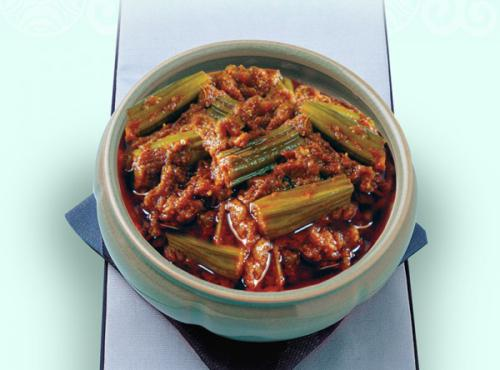
 3. Wrongly labelled veggies. Below example was labelled as cauliflower by search engine. These kind of images need to be removed. 
     > 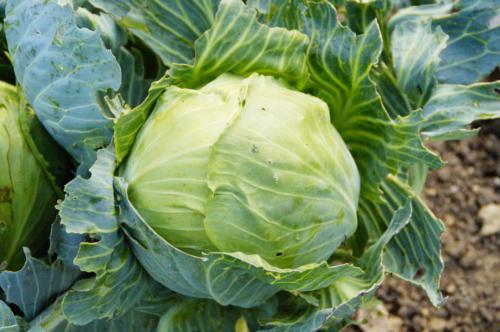

## Data augumentation

> <p>The number of images collected for this exercise varies between 15 to 300 approximate. In order for the network to train and generalize better we used data augumentation technique. We use fastai get_transforms method to transform the images during training a model.</p>

Below we show what kind of transformation are applied for a single image when get_transforms() method is used
> * do_flip: default = True - a random flip is applied with probability 0.5
> * max_rotate: default = 10.0 - if not None, a random rotation between -max_rotate and max_rotate degrees is applied with probability p_affine
> * max_zoom: default = 1.1 - if not 1. or less, a random zoom between 1. and max_zoom is applied with probability p_affine
> * max_lighting: default = 0.2 - if not None, a random lightning and contrast change controlled by max_lighting is applied with probability p_lighting
> * max_warp: default = 0.2 - if not None, a random symmetric warp of magnitude between -max_warp and maw_warp is applied with probability p_affine
> * p_affine: default = 0.75 - the probability that each affine transform and symmetric warp is applied
> * p_lighting: default = 0.75 - the probability that each lighting transform is applied
> * size = 224/229. This will resize the immage to 224 or 229. For our test we found 229 size had slightly higher accuracy. 
* <b> Note</b>: With few experiements it was found that default values provide better accuracy for this case.

Reference - https://docs.fast.ai/vision.transform.html#Image-transforms


In [15]:
# Get default transformation
tfms = get_transforms()

In [26]:
# Example of how get transforms changes an image
def get_ex(): return open_image('../Data/images/carrot/00000294.jpg')

def plots_f(rows, cols, width, height, **kwargs):
    [get_ex().apply_tfms(tfms[0], **kwargs).show(ax=ax) for i,ax in enumerate(plt.subplots(
        rows,cols,figsize=(width,height))[1].flatten())]

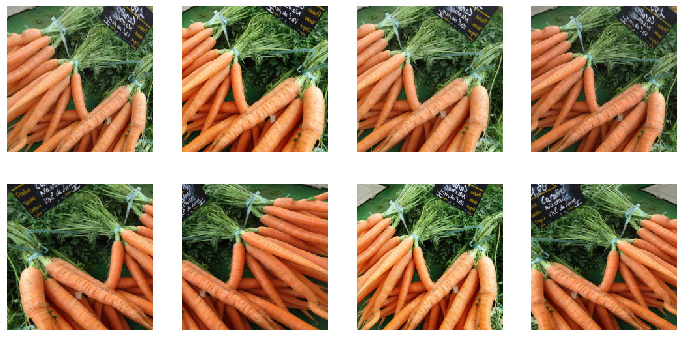

In [27]:
plots_f(2, 4, 12, 6, size=224)

In [28]:
imgpath = Path('../Data/images')
data = ImageDataBunch.from_folder(imgpath, train=".",valid_pct=0.2,
        ds_tfms=get_transforms(), size=224, num_workers=4,bs=16)

In [29]:
data

ImageDataBunch;

Train: LabelList (7284 items)
x: ImageList
Image (3, 224, 224),Image (3, 224, 224),Image (3, 224, 224),Image (3, 224, 224),Image (3, 224, 224)
y: CategoryList
ash gourd,ash gourd,ash gourd,ash gourd,ash gourd
Path: ..\Data\images;

Valid: LabelList (1820 items)
x: ImageList
Image (3, 224, 224),Image (3, 224, 224),Image (3, 224, 224),Image (3, 224, 224),Image (3, 224, 224)
y: CategoryList
white raddish,lime,chilli,curry leaves,turnip
Path: ..\Data\images;

Test: None

In [32]:
data.batch_stats()

[tensor([0.5767, 0.6070, 0.4229]), tensor([0.3448, 0.2996, 0.3385])]

In [33]:
data1.batch_stats()

[tensor([0.6901, 0.8070, 0.2048]), tensor([1.2618, 1.2212, 1.5278])]

## Data Preprocessing
> As part of preprocessing we normalize the data. Normalization refers to normalizing the data dimensions so that they are approximately of same scale. In Fastai we can call normalize function to normalize the images. We have an option to use imagenet_stats, cifar_stats, mnist_stats. As we are using transfer learning based on imagenet, we will be using imagenet_stats.
Imagenet (Mean, Std) = ([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])

Reference
* http://cs231n.github.io/neural-networks-2/
* https://docs.fast.ai/vision.data.html#ImageDataBunch.normalize

In [38]:
print(imagenet_stats)

([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])


In [30]:
data1 = ImageDataBunch.from_folder(imgpath, train=".",valid_pct=0.2,
        ds_tfms=get_transforms(), size=224, num_workers=4,bs=16).normalize(imagenet_stats)
data1

ImageDataBunch;

Train: LabelList (7284 items)
x: ImageList
Image (3, 224, 224),Image (3, 224, 224),Image (3, 224, 224),Image (3, 224, 224),Image (3, 224, 224)
y: CategoryList
ash gourd,ash gourd,ash gourd,ash gourd,ash gourd
Path: C:\Users\sriga\Desktop\ML\Springboard\vegetable-classifier\Data\images;

Valid: LabelList (1820 items)
x: ImageList
Image (3, 224, 224),Image (3, 224, 224),Image (3, 224, 224),Image (3, 224, 224),Image (3, 224, 224)
y: CategoryList
lemon,carrot,basil,drumstick,okra
Path: C:\Users\sriga\Desktop\ML\Springboard\vegetable-classifier\Data\images;

Test: None

## Testing data

> The training and validation is from same distribution i.e image collected from web.
> We wanted to build seperate testing data set to verify real world performance.
> In real world this application is expected to be used majorly with mobile captured images. Hence the testing data set is created out of images captured from a mobile

### Test image examples

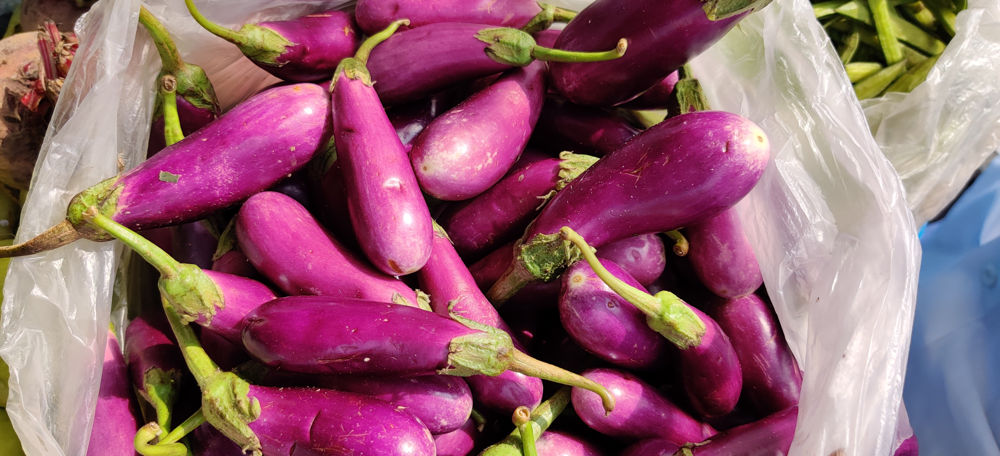

In [30]:
open_image('../Data/test/34_brinjal.jpg')

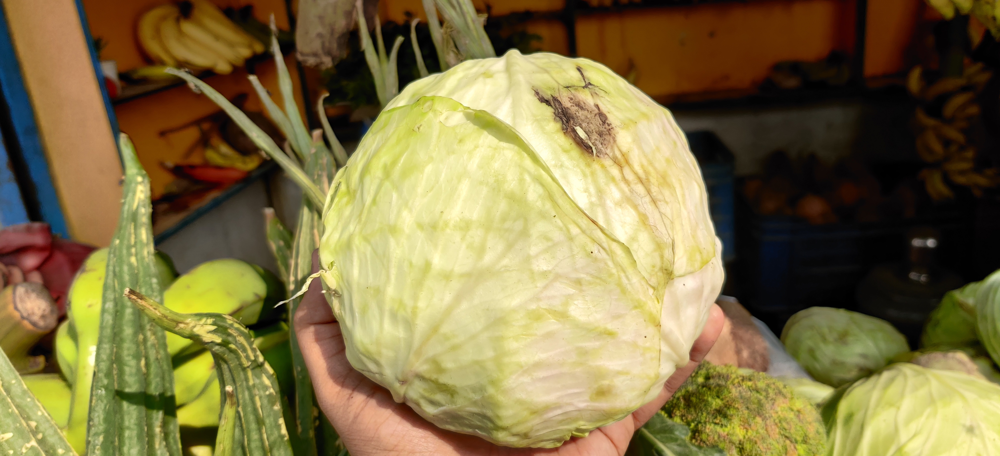

In [31]:
open_image('../Data/test/42_cabbage.jpg')